In [1]:
!pip install l5kit
!pip install zarr

Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
Defaulting to user installation because normal site-packages is not writeable
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


https://www.kaggle.com/kool777/lyft-level5-eda-training-inference

↑参考　これがなきゃマジで死んでた，感謝…！

In [38]:
from pathlib import Path
import pandas as pd
import numpy as np
import os
os.environ["L5KIT_DATA_FOLDER"] = '/home/knikaido/work/Lyft/data/lyft-motion-prediction-autonomous-vehicles'
import zarr
from prettytable import PrettyTable
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

from l5kit.data import PERCEPTION_LABELS
from l5kit.rasterization import build_rasterizer
from l5kit.configs import load_config_data
from l5kit.visualization import draw_trajectory, TARGET_POINTS_COLOR
from l5kit.geometry import transform_points
from l5kit.data import ChunkedDataset, LocalDataManager
from l5kit.dataset import EgoDataset, AgentDataset

In [2]:
INPUT_ROOT = Path('/home/knikaido/work/Lyft/data/')
SAMPLE_ZARR = INPUT_ROOT / 'lyft-motion-prediction-autonomous-vehicles/scenes/sample.zarr'

cfg = load_config_data(str(INPUT_ROOT / "lyft-config-files/visualisation_config.yaml"))

In [3]:
sample_zarr = zarr.open(str(SAMPLE_ZARR))

In [4]:
sample_zarr.info

Name,/
Type,zarr.hierarchy.Group
Read-only,False
Store type,zarr.storage.DirectoryStore
No. members,5
No. arrays,4
No. groups,1
Arrays,"agents, frames, scenes, traffic_light_faces"
Groups,agents_mask


In [5]:
dm = LocalDataManager()
dataset_path = dm.require(cfg["val_data_loader"]["key"])
zarr_dataset = ChunkedDataset(dataset_path)
zarr_dataset.open()
print(zarr_dataset)

+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
| Num Scenes | Num Frames | Num Agents | Total Time (hr) | Avg Frames per Scene | Avg Agents per Frame | Avg Scene Time (sec) | Avg Frame frequency |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+
|    100     |   24838    |  1893736   |       0.69      |        248.38        |        76.24         |        24.83         |        10.00        |
+------------+------------+------------+-----------------+----------------------+----------------------+----------------------+---------------------+


In [6]:
print(dataset_path)

/home/knikaido/work/Lyft/data/lyft-motion-prediction-autonomous-vehicles/scenes/sample.zarr


## agent

In [7]:
agents = pd.DataFrame.from_records(zarr_dataset.agents, columns = ['centroid', 'extent', 'yaw', 'velocity', 'track_id', 'label_probabilities'])
agents[['centroid_x','centroid_y']] = agents['centroid'].to_list()
agents = agents.drop('centroid', axis=1)
agents[['extent_x','extent_y', 'extent_z']] = agents['extent'].to_list()
agents = agents.drop('extent', axis=1)
agents[['velocity_x','velocity_y']] = agents['velocity'].to_list()
agents = agents.drop('velocity', axis=1)
agents.head()

,yaw,track_id,label_probabilities,centroid_x,centroid_y,extent_x,extent_y,extent_z,velocity_x,velocity_y
0,1.016675,1,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",665.034241,-2207.512207,4.391328,1.813830,1.590976,0.0,0.0
1,-0.783224,2,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",717.661255,-2173.760010,5.150925,1.953092,2.040210,0.0,0.0
2,-0.321747,3,"[0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",730.681396,-2180.678955,2.948282,1.484217,1.112507,0.0,0.0
3,0.785501,4,"[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",671.253601,-2204.745361,1.706702,0.928787,0.628216,0.0,0.0
4,1.492359,5,"[0.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",669.776306,-2213.004639,0.251099,0.634378,1.654377,0.0,0.0


__やっっっっとzarrの中身見ることができた！！！！__

とりあえず，agentの中身を見れた．<br>
extentは，大きさ的なことみたい．

In [8]:
agents = zarr_dataset.agents
probabilities = agents["label_probabilities"]
labels_indexes = np.argmax(probabilities, axis=1)
counts = []
for idx_label, label in enumerate(PERCEPTION_LABELS):
    counts.append(np.sum(labels_indexes == idx_label))
    
table = PrettyTable(field_names=["label", "counts"])
for count, label in zip(counts, PERCEPTION_LABELS):
    table.add_row([label, count])
print(table)

+------------------------------------+---------+
|               label                |  counts |
+------------------------------------+---------+
|      PERCEPTION_LABEL_NOT_SET      |    0    |
|      PERCEPTION_LABEL_UNKNOWN      | 1324481 |
|     PERCEPTION_LABEL_DONTCARE      |    0    |
|        PERCEPTION_LABEL_CAR        |  519385 |
|        PERCEPTION_LABEL_VAN        |    0    |
|       PERCEPTION_LABEL_TRAM        |    0    |
|        PERCEPTION_LABEL_BUS        |    0    |
|       PERCEPTION_LABEL_TRUCK       |    0    |
| PERCEPTION_LABEL_EMERGENCY_VEHICLE |    0    |
|   PERCEPTION_LABEL_OTHER_VEHICLE   |    0    |
|      PERCEPTION_LABEL_BICYCLE      |    0    |
|    PERCEPTION_LABEL_MOTORCYCLE     |    0    |
|      PERCEPTION_LABEL_CYCLIST      |   6688  |
|   PERCEPTION_LABEL_MOTORCYCLIST    |    0    |
|    PERCEPTION_LABEL_PEDESTRIAN     |  43182  |
|      PERCEPTION_LABEL_ANIMAL       |    0    |
|     AVRESEARCH_LABEL_DONTCARE      |    0    |
+-------------------

__ラベルは，実際三種+不明しかない．不明のデータ数がめっっっっちゃおおい(ただし，sample)．__

## scene

In [10]:
scenes = pd.DataFrame.from_records(zarr_dataset.scenes, columns = ['frame_index_interval', 'host', 'start_time', 'end_time'])
scenes[['frame_start_index','frame_end_index']] = scenes['frame_index_interval'].to_list()
scenes = scenes.drop('frame_index_interval', axis=1)
scenes.head()

,host,start_time,end_time,frame_start_index,frame_end_index
0,host-a013,1572643684617362176,1572643709617362176,0,248
1,host-a013,1572643749559148288,1572643774559148288,248,497
2,host-a013,1572643774559148288,1572643799559148288,497,746
3,host-a013,1572643799559148288,1572643824559148288,746,995
4,host-a013,1572643824559148288,1572643849559148288,995,1244


hostは，収集した車らしい．

## frame

In [12]:
frames = pd.DataFrame.from_records(zarr_dataset.frames, columns = ['timestamp', 'agent_index_interval', 'traffic_light_faces_index_interval', 'ego_translation','ego_rotation'])
frames[['ego_translation_x', 'ego_translation_y', 'ego_translation_z']] = frames['ego_translation'].to_list()
frames = frames.drop('ego_translation', axis=1)
frames.head()

,timestamp,agent_index_interval,traffic_light_faces_index_interval,ego_rotation,ego_translation_x,ego_translation_y,ego_translation_z
0,1572643684801892606,"[0, 38]","[0, 0]","[[0.5467331409454346, -0.837294340133667, 0.00...",680.619751,-2183.327637,288.541138
1,1572643684901714926,"[38, 85]","[0, 0]","[[0.5470812916755676, -0.837059736251831, 0.00...",681.185608,-2182.422363,288.608124
2,1572643685001499246,"[85, 142]","[0, 0]","[[0.5479603409767151, -0.8364874720573425, 0.0...",681.764709,-2181.522705,288.680939
3,1572643685101394026,"[142, 200]","[0, 0]","[[0.5491225123405457, -0.8357341885566711, 0.0...",682.341431,-2180.624268,288.755920
4,1572643685201412346,"[200, 254]","[0, 0]","[[0.5504215955734253, -0.8348868489265442, -7....",682.919800,-2179.730469,288.827393


ego_translationは，hostの位置

## traffic light

In [13]:
traffic_light_faces = pd.DataFrame.from_records(zarr_dataset.tl_faces, columns = ['face_id', 'traffic_light_id', 'traffic_light_face_status'])
traffic_light_faces.head()

,face_id,traffic_light_id,traffic_light_face_status
0,xbVG,/ggb,"[0.0, 0.0, 1.0]"
1,jutE,/ggb,"[0.0, 0.0, 1.0]"
2,CDDo,/ggb,"[0.0, 0.0, 1.0]"
3,xbVG,/ggb,"[0.0, 0.0, 1.0]"
4,jutE,/ggb,"[0.0, 0.0, 1.0]"


信号機の順番は，red/green/yellow

## visualize

/usr/local/lib/python3.6/dist-packages/matplotlib/figure.py:448: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  % get_backend())


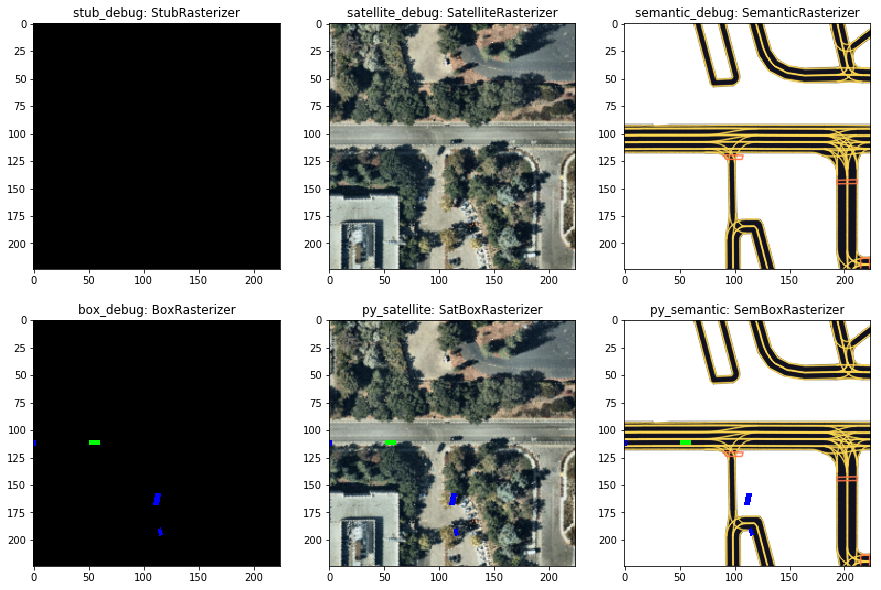

In [15]:
sns.set_style({'axes.grid': False})

def visualize_rgb_image(dataset, index, title="", ax=None):
    """Visualizes Rasterizer's RGB image"""
    data = dataset[index]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)

    if ax is None:
        fig, ax = plt.subplots()
    if title:
        ax.set_title(title)
    ax.imshow(im[::-1])
# Prepare all rasterizer and EgoDataset for each rasterizer
rasterizer_dict = {}
dataset_dict = {}

rasterizer_type_list = ["py_satellite", "satellite_debug", "py_semantic", "semantic_debug", "box_debug", "stub_debug"]

for i, key in enumerate(rasterizer_type_list):
    # print("key", key)
    cfg["raster_params"]["map_type"] = key
    rasterizer_dict[key] = build_rasterizer(cfg, dm)
    dataset_dict[key] = EgoDataset(cfg, zarr_dataset, rasterizer_dict[key])
fig, axes = plt.subplots(2, 3, figsize=(15, 10))
axes = axes.flatten()
for i, key in enumerate(["stub_debug", "satellite_debug", "semantic_debug", "box_debug", "py_satellite", "py_semantic"]):
    visualize_rgb_image(dataset_dict[key], index=0, title=f"{key}: {type(rasterizer_dict[key]).__name__}", ax=axes[i])
fig.show()

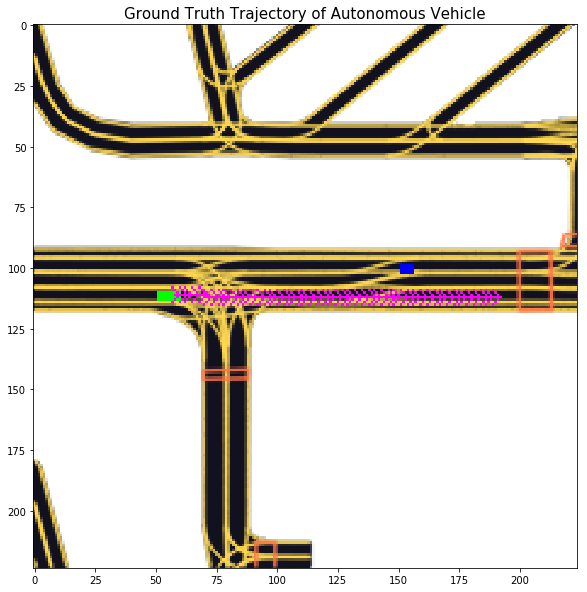

In [16]:
cfg["raster_params"]["map_type"] = "py_semantic"

# raster object for visualization
rast = build_rasterizer(cfg, dm)

# EgoDataset object
dataset = EgoDataset(cfg, zarr_dataset, rast)

# select one example from our dataset
data = dataset[50]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])

# plot ground truth trajectory
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Ground Truth Trajectory of Autonomous Vehicle',fontsize=15)
plt.imshow(im[::-1])
plt.show()

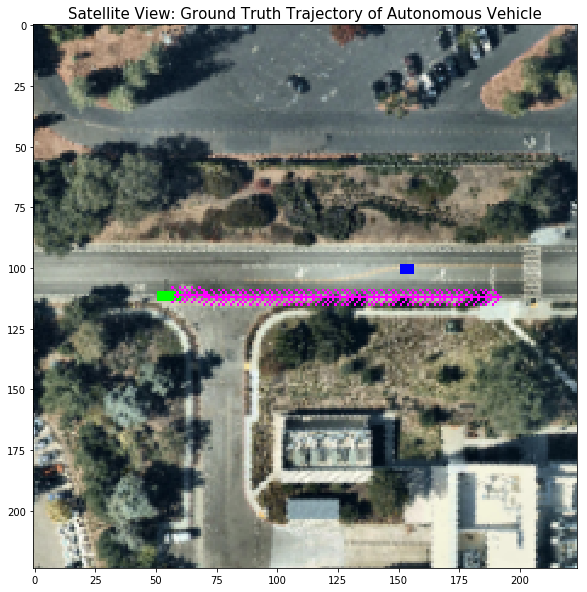

In [17]:
cfg["raster_params"]["map_type"] = "py_satellite"
rast = build_rasterizer(cfg, dm)

# EgoDataset object
dataset = EgoDataset(cfg, zarr_dataset, rast)
data = dataset[50]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Satellite View: Ground Truth Trajectory of Autonomous Vehicle',fontsize=15)
plt.imshow(im[::-1])
plt.show()

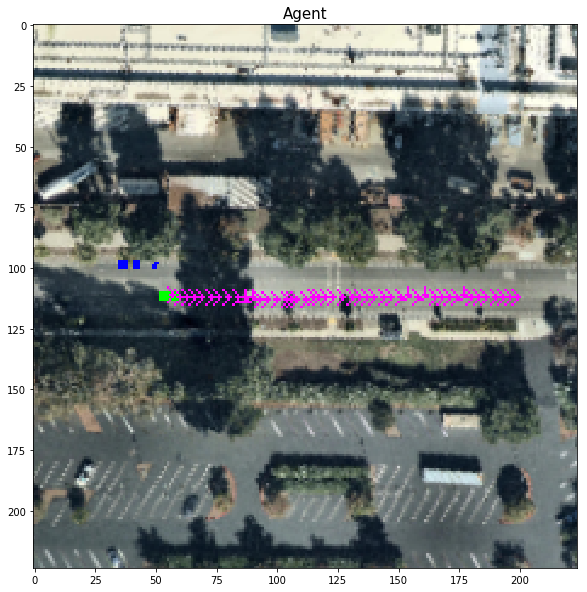

In [31]:
# AgentDataset object
dataset = AgentDataset(cfg, zarr_dataset, rast)
data = dataset[50]

im = data["image"].transpose(1, 2, 0)
im = dataset.rasterizer.to_rgb(im)
target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)

plt.rcParams['figure.figsize'] = 10, 10
plt.title('Agent',fontsize=15)
plt.imshow(im[::-1])
plt.show()

In [36]:
# animation for scene
def animate_solution(images):

    def animate(i):
        im.set_data(images[i])
 
    fig, ax = plt.subplots()
    im = ax.imshow(images[0])
    
    return animation.FuncAnimation(fig, animate, frames=len(images), interval=80)

/usr/local/lib/python3.6/dist-packages/matplotlib/__init__.py:886: MatplotlibDeprecationWarning: 
examples.directory is deprecated; in the future, examples will be found relative to the 'datapath' directory.
  "found relative to the 'datapath' directory.".format(key))


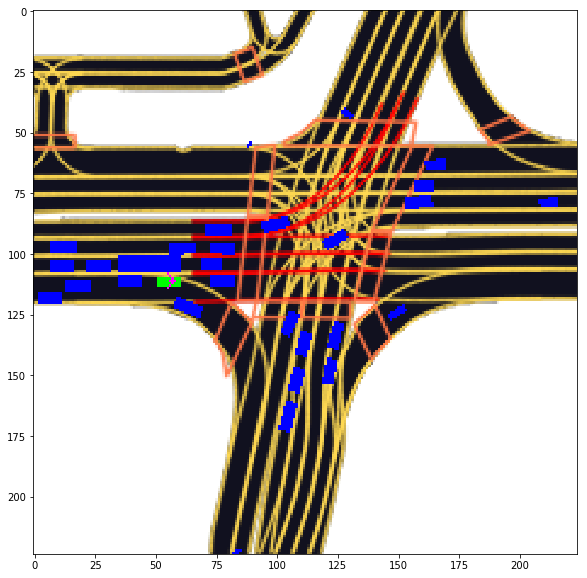

In [39]:
from IPython.display import display, clear_output
import PIL
 
cfg["raster_params"]["map_type"] = "py_semantic"
rast = build_rasterizer(cfg, dm)
dataset = EgoDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
    
# animation    
anim = animate_solution(images)
HTML(anim.to_jshtml())

Animation size has reached 21033701 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


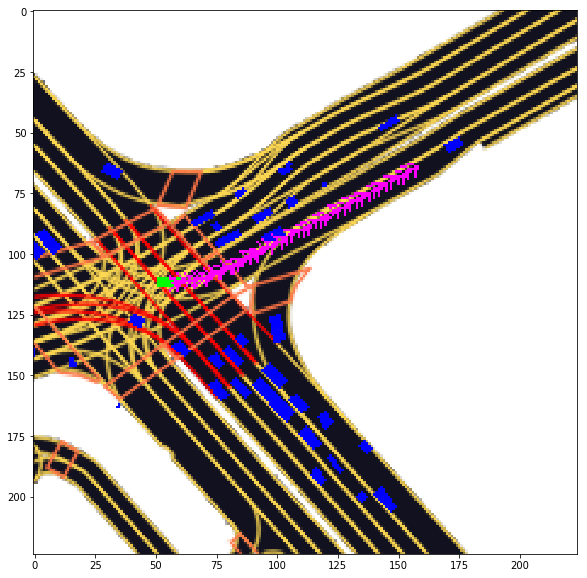

In [40]:
from IPython.display import display, clear_output
import PIL
 
cfg["raster_params"]["map_type"] = "py_semantic"
rast = build_rasterizer(cfg, dm)
dataset = AgentDataset(cfg, zarr_dataset, rast)
scene_idx = 34
indexes = dataset.get_scene_indices(scene_idx)
images = []

for idx in indexes:
    
    data = dataset[idx]
    im = data["image"].transpose(1, 2, 0)
    im = dataset.rasterizer.to_rgb(im)
    target_positions_pixels = transform_points(data["target_positions"] + data["centroid"][:2], data["world_to_image"])
    center_in_pixels = np.asarray(cfg["raster_params"]["ego_center"]) * cfg["raster_params"]["raster_size"]
    draw_trajectory(im, target_positions_pixels, data["target_yaws"], TARGET_POINTS_COLOR)
    clear_output(wait=True)
    images.append(PIL.Image.fromarray(im[::-1]))
    
# animation    
anim = animate_solution(images)
HTML(anim.to_jshtml())

dataset「AgentDataset」と，「EgoDataset」がある．